In [1]:
import numpy as np
import matplotlib.pyplot as plt
import folium

In [2]:
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from numpy import genfromtxt
import pandas as pd

In [3]:
my_data = genfromtxt('merged2.csv', delimiter=',')

In [3]:
import time
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph

cols = ['ID', 'PropertyFullStreetAddress', 'PropertyAddressUnitNumber',
       'PropertyCity', 'County', 'PropertyZip', 'PropertyAddressLatitude',
       'PropertyAddressLongitude', 'BuildingAreaSqFt', 'LotSizeSquareFeet',
       'FireplaceNumber', 'YearBuilt', 'NoOfStories', 'TotalBedrooms',
       'NormalizedBathCount', 'LandAssessedValue', 'ImprovementAssessedValue',
       'TotalAssessedValue', 'GarageNoOfCars', 'NormalizedListPrice',
       'ListDate', 'NormalizedSalePrice', 'SoldDate', 'ListYearMonth',
       'SoldYearMonth', 'MonthsToSale', 'NormalizedSalesPremium',
       'built_prct']
data = pd.read_csv("./merged2.csv", header=None, names=cols)

data['price_z'] = (data['NormalizedSalePrice'] - data['NormalizedSalePrice'].mean())/data['NormalizedSalePrice'].std(ddof=0)
data['lat_z'] = (data['PropertyAddressLatitude'] - data['PropertyAddressLatitude'].mean())/data['PropertyAddressLatitude'].std(ddof=0)
data['lon_z'] = (data['PropertyAddressLongitude'] - data['PropertyAddressLongitude'].mean())/data['PropertyAddressLongitude'].std(ddof=0)
data['lot_z'] = (data['LotSizeSquareFeet'] - data['LotSizeSquareFeet'].mean())/data['LotSizeSquareFeet'].std(ddof=0)

# In merged2, we added normalized sales premium, months to sale, and built %, all of which should be alright without z normalization
# In merged3, we added tfidfs for transportation (zipcode based) and monthly median revenue (again, zipcode based)
subset = data[['PropertyZip',"lat_z", "lon_z", "price_z", "lot_z","LotSizeSquareFeet", "YearBuilt", "TotalBedrooms", "NormalizedBathCount", "PropertyAddressLatitude", 'PropertyAddressLongitude', 'NormalizedSalePrice', 'MonthsToSale', 'NormalizedSalesPremium', 'built_prct']].dropna()




In [4]:
# Let's 1-hot encode zip, year built
OneHotZips = pd.get_dummies(subset['PropertyZip'], prefix='zip')
OneHotYearBuilt = pd.get_dummies(subset['YearBuilt'], prefix='year_built', drop_first=True)

In [5]:
# use pd.concat to join the new columns with our original dataframe
subset = pd.concat([subset,OneHotZips],axis=1)
subset = pd.concat([subset,OneHotYearBuilt],axis=1)

# now drop the original 'Zip', 'YearBuilt' columns (we don't need them anymore)
subset.drop(['PropertyZip', 'YearBuilt'],axis=1, inplace=True)

In [6]:
downsampled = subset.sample(n=10000)

downsampled_z_cols = ["lat_z", "lon_z", "price_z", "lot_z", "TotalBedrooms", "NormalizedBathCount", "built_prct"] +\
                            list(OneHotZips.columns.values) +\
                            list(OneHotYearBuilt.columns.values)

just_lat_long = downsampled[["PropertyAddressLatitude", "PropertyAddressLongitude"]]
#downsampled = downsampled[["lat_z", "lon_z", 'PropertyZip', "price_z", "lot_z", "YearBuilt", "TotalBedrooms", "NormalizedBathCount"]]
downsampled_z = downsampled[downsampled_z_cols]

print(downsampled.head())

          lat_z     lon_z   price_z     lot_z  LotSizeSquareFeet  \
25841  0.515711 -1.211745  0.388212 -0.036531            14924.0   
14677  0.773624  1.450076 -0.604376 -0.092132             7327.0   
29426  0.645212  1.038447 -0.814150 -0.111871             4630.0   
9006   0.886147 -0.381774 -0.353671 -0.099151             6368.0   
2818   0.210335  0.130751  3.931341  0.092580            32565.0   

       TotalBedrooms  NormalizedBathCount  PropertyAddressLatitude  \
25841            0.0                  3.5                30.355744   
14677            0.0                  2.5                30.381599   
29426            0.0                  1.5                30.368726   
9006             3.0                  2.0                30.392879   
2818             0.0                  2.0                30.325131   

       PropertyAddressLongitude  NormalizedSalePrice  ...  year_built_2008.0  \
25841                -97.899782             615000.0  ...                  0   
14677     

In [7]:
downsampled_z_np = downsampled_z.values
just_lat_long_np = just_lat_long.values

KeyboardInterrupt: 

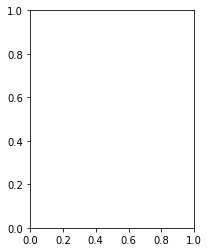

In [17]:

# Create a graph capturing local connectivity. Larger number of neighbors
# will give more homogeneous clusters to the cost of computation
# time. A very large number of neighbors gives more evenly distributed
# cluster sizes, but may not impose the local manifold structure of
# the data
knn_graph = kneighbors_graph(just_lat_long_np, 5, include_self=False)

for connectivity in (None, knn_graph):
    for n_clusters in (3, 10, 30):
        plt.figure(figsize=(10, 4))
        for index, linkage in enumerate(('average',
                                         'complete',
                                         'ward')):
            plt.subplot(1, 3, index + 1)
            model = AgglomerativeClustering(linkage=linkage,
                                            connectivity=connectivity,
                                            n_clusters=n_clusters)
            t0 = time.time()
            model.fit(downsampled_z_np)
            elapsed_time = time.time() - t0
            # plot by lat/long
            plt.scatter(downsampled_z_np[:, 0], downsampled_z_np[:, 1], c=model.labels_,
                        cmap=plt.cm.nipy_spectral, s=1)
            plt.title('linkage=%s\n(time %.2fs)' % (linkage, elapsed_time),
                      fontdict=dict(verticalalignment='top'))
            plt.axis('equal')
            plt.axis('off')

            plt.subplots_adjust(bottom=0, top=.89, wspace=0,
                                left=0, right=1)
            plt.suptitle('n_cluster=%i, connectivity=%r' %
                         (n_clusters, connectivity is not None), size=17)


plt.show()

/home/frederic/anaconda3/lib/python3.6/site-packages/sklearn/cluster/hierarchical.py:244: UserWarning: the number of connected components of the connectivity matrix is 80 > 1. Completing it to avoid stopping the tree early.
  affinity='euclidean')


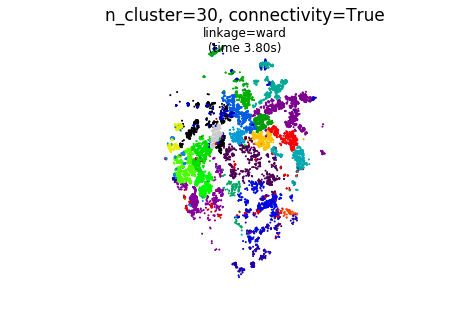

In [10]:
knn_graph = kneighbors_graph(just_lat_long_np, 5, include_self=False)

connectivity = knn_graph
n_clusters = 30
linkage = 'ward'


model = AgglomerativeClustering(linkage=linkage,
                                connectivity=connectivity,
                                n_clusters=n_clusters)

model.fit(downsampled_z_np)

# plot by lat/long
plt.scatter(downsampled_z_np[:, 0], downsampled_z_np[:, 1], c=model.labels_,
            cmap=plt.cm.nipy_spectral, s=1)
plt.title('linkage=%s\n(time %.2fs)' % (linkage, elapsed_time),
          fontdict=dict(verticalalignment='top'))
plt.axis('equal')
plt.axis('off')

plt.subplots_adjust(bottom=0, top=.89, wspace=0,
                    left=0, right=1)
plt.suptitle('n_cluster=%i, connectivity=%r' %
             (n_clusters, connectivity is not None), size=17)


plt.show()

In [11]:
### DESCRIPTION OF ABOVE $$$
# We vary
# -- the number of clusters (3, 10, 30)
# -- whether or not things need to be connected, as defined by a knn on just lat/long
# -- the linkage to use

# see https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html

In [12]:
downsampled_z_np.shape

(10000, 162)

## Neighborhood and Cluster ID

In [13]:
# https://stackoverflow.com/questions/20776205/point-in-polygon-with-geojson-in-python

In [14]:
import shapefile
from shapely.geometry import shape, mapping, Point, Polygon, MultiPolygon

ModuleNotFoundError: No module named 'shapefile'

In [ ]:
polygon = Polygon([(0, 0), (1, 1), (1, 0)])
point = Point([0.5, 0.1])

point.within(polygon)

In [ ]:
polys = shapefile.Reader("mygeodata/travis_county-polygon.shp")


In [ ]:
import matplotlib.pyplot as plt
plt.figure()
for s in polys.shapeRecords():
    x = [i[0] for i in s.shape.points[:]]
    y = [i[1] for i in s.shape.points[:]]
    plt.plot(x,y)
plt.show()

In [ ]:
polys.shapeRecords()[0].shape.__geo_interface__

In [ ]:
def getNeighborhoodID(lat, long):
    point = Point([long, lat])

    for i, p in enumerate(polys.shapeRecords()):
        multi = shape(p.shape.__geo_interface__)
        
        if point.within(multi):
            return i
    return -1
getNeighborhoodID(30.2694, -97.7271)

In [ ]:
downsampled['neighborhood'] = downsampled.apply(lambda x: getNeighborhoodID(x['PropertyAddressLatitude'], x['PropertyAddressLongitude']), axis=1)



In [ ]:
downsampled['cluster'] = model.labels_

In [ ]:
def most_common(lst):
    return max(set(lst), key=lst.count)

In [216]:
num_of_neighborhoods = max(downsampled['neighborhood']) + 1
non_matching_neighborhoods = []

for i in range(num_of_neighborhoods):
    if len(downsampled[downsampled['neighborhood']==i]) == 0:
        print(i)
        non_matching_neighborhoods.append(i)

1
8
11
55


In [217]:
for i in non_matching_neighborhoods:
    grouped[i] = [-1]

grouped = grouped.reindex(range(num_of_neighborhoods))

In [ ]:
grouped = downsampled.groupby('neighborhood')['cluster'].apply(list)
neighborhood_to_cluster = {}

for i, x in enumerate(grouped):
    neighborhood_to_cluster[i] = most_common(x)


In [ ]:
downsampled['neigh_match_clust'] = downsampled.apply(lambda x : neighborhood_to_cluster.get(x['neighborhood'], -2) == x['cluster'], axis=1)
downsampled['neigh_match_clust']


In [220]:
sum(downsampled['neigh_match_clust'])

2662

## Plotting

In [ ]:
import json
#geojson = '/Users/petergrabowski/Downloads/ZillowNeighborhoods-TX/austin.geoson'
geojson = 'mygeodata/austin.geojson'
with open(geojson) as jsonfile:
    geos = json.load(jsonfile)

In [ ]:
features = geos['features']
new_features = []

for f in features:
    cityname = f.get('properties',{}).get('City',"")
    countyname = f.get('properties',{}).get('County',"")
    if countyname == 'Travis':
        new_features.append(f)


    

In [ ]:
geos['features'] = new_features

In [ ]:
with open('travis_county.geojson', 'w') as outfile:
    json.dump(geos, outfile)

In [ ]:
near_zoom = 10
far_zoom = 6
lat = 30.2725
lon = -97.7069

In [ ]:
from folium import plugins

In [ ]:
ic1 = plugins.BeautifyIcon(icon='circle', border_color='#b3334f')

In [ ]:
def get_color(index):
    colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred',
             'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue',
             'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen',
             'gray', 'black', 'lightgray']
    i = index % len(colors)
    
    return colors[i]
    


In [ ]:
m = folium.Map(location=[lat, lon], tiles='Stamen Toner', zoom_start=near_zoom, zoom_control=False, control_scale=True)

num_to_plot = 10000
for lat, lon, label in zip(just_lat_long_np[:, 0][:num_to_plot], just_lat_long_np[:, 1][:num_to_plot], model.labels_[:num_to_plot]):
    folium.Circle(
    radius=0.1,
    location=[lat,lon],
    color=get_color(label),
    fill=False,
                ).add_to(m)

folium.GeoJson(geos).add_to(m)
filename = 'cluster_austin_neighborhoods_' + str(num_to_plot) + '.html'
m.save('clustering_outputs/' + filename)

In [210]:
# Plot matches only

m = folium.Map(location=[lat, lon], tiles='Stamen Toner', zoom_start=near_zoom, zoom_control=False, control_scale=True)

for lat, lon, label in zip(just_lat_long_np[:, 0][downsampled['neigh_match_clust']], just_lat_long_np[:, 1][downsampled['neigh_match_clust']], model.labels_[downsampled['neigh_match_clust']]):
    folium.Circle(
    radius=0.1,
    location=[lat,lon],
    color=get_color(label),
    fill=False,
                ).add_to(m)

folium.GeoJson(geos).add_to(m)
filename = 'cluster_austin_neighborhoods_' + 'matches' + '.html'
m.save('clustering_outputs/' + filename)

In [215]:
# Plot non-matches only

m = folium.Map(location=[lat, lon], tiles='Stamen Toner', zoom_start=near_zoom, zoom_control=False, control_scale=True)

non_matches = [not i for i in downsampled['neigh_match_clust']]

for lat, lon, label in zip(just_lat_long_np[:, 0][non_matches], just_lat_long_np[:, 1][non_matches], model.labels_[non_matches]):
    folium.Circle(
    radius=0.1,
    location=[lat,lon],
    color=get_color(label),
    fill=False,
                ).add_to(m)

folium.GeoJson(geos).add_to(m)
filename = 'cluster_austin_neighborhoods_' + 'non-matches' + '.html'
m.save('clustering_outputs/' + filename)

In [ ]:
from folium.plugins import FastMarkerCluster
m = folium.Map(location=[lat, lon], tiles='Stamen Toner', zoom_start=near_zoom, zoom_control=False, control_scale=True)
# add all the point from the file to the map object using FastMarkerCluster
m.add_child(FastMarkerCluster(just_lat_long.values.tolist()))

## XGBoost

In [36]:
from xgboost import XGBRegressor
from xgboost import plot_tree
import matplotlib

In [37]:
model = XGBRegressor(max_depth=5, n_estimators=100, subsample= 1.0, learning_rate=0.3, random_state=47)

In [38]:
x = downsampled[["PropertyAddressLatitude", "PropertyAddressLongitude", "LotSizeSquareFeet", "TotalBedrooms", "NormalizedBathCount", "built_prct"] +\
                            list(OneHotZips.columns.values) +\
                            list(OneHotYearBuilt.columns.values)]
y = downsampled[['NormalizedSalePrice']] #other possibilities: "NormalizedSalePremium", "MonthsToSale"
trained_model = model.fit(x, y)

In [39]:
trained_model

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, importance_type='gain',
       learning_rate=0.3, max_delta_step=0, max_depth=5,
       min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
       nthread=None, objective='reg:linear', random_state=47, reg_alpha=0,
       reg_lambda=1, scale_pos_weight=1, seed=None, silent=True,
       subsample=1.0)

In [ ]:
#plt.close(fig)

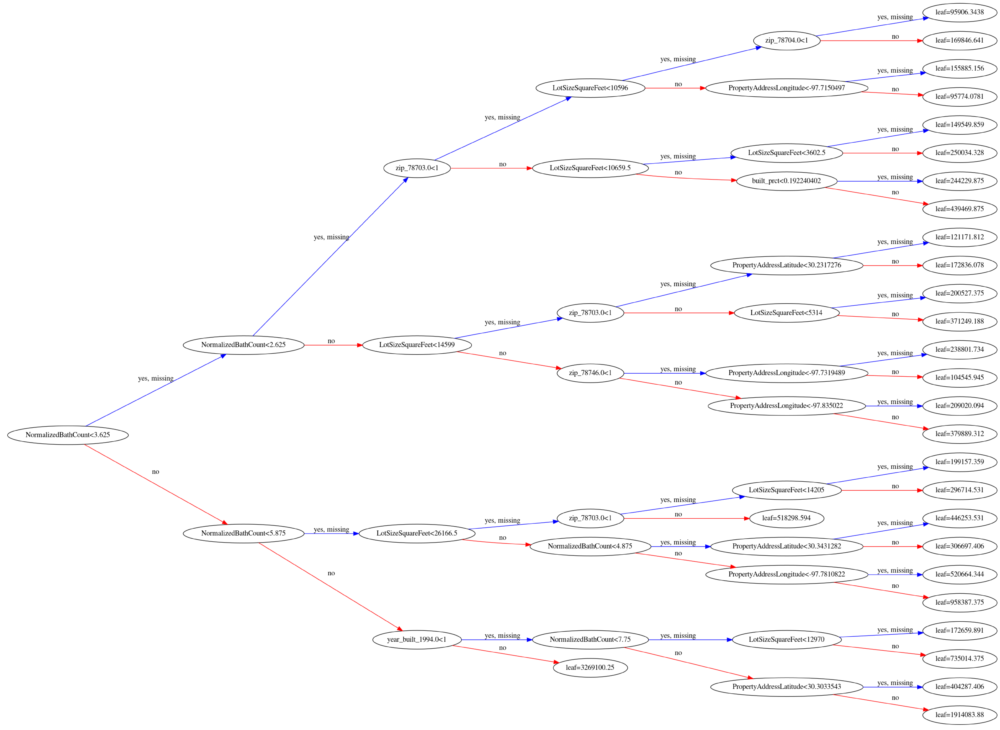

In [19]:
plot_tree(trained_model, rankdir='LR')
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(150, 100)

In [ ]:
# we can likely pull the cuts out from the trained model doing somethign
# similar to what plot_tree does. see source here:
# https://github.com/dmlc/xgboost/blob/master/python-package/xgboost/plotting.py#L244

# Source #2 here:
# https://towardsdatascience.com/interpretable-machine-learning-with-xgboost-9ec80d148d27
# https://github.com/slundberg/shap/blob/master/notebooks/tree_explainer/Census%20income%20classification%20with%20XGBoost.ipynb

In [8]:
import xgboost
import shap
import matplotlib.pylab as pl

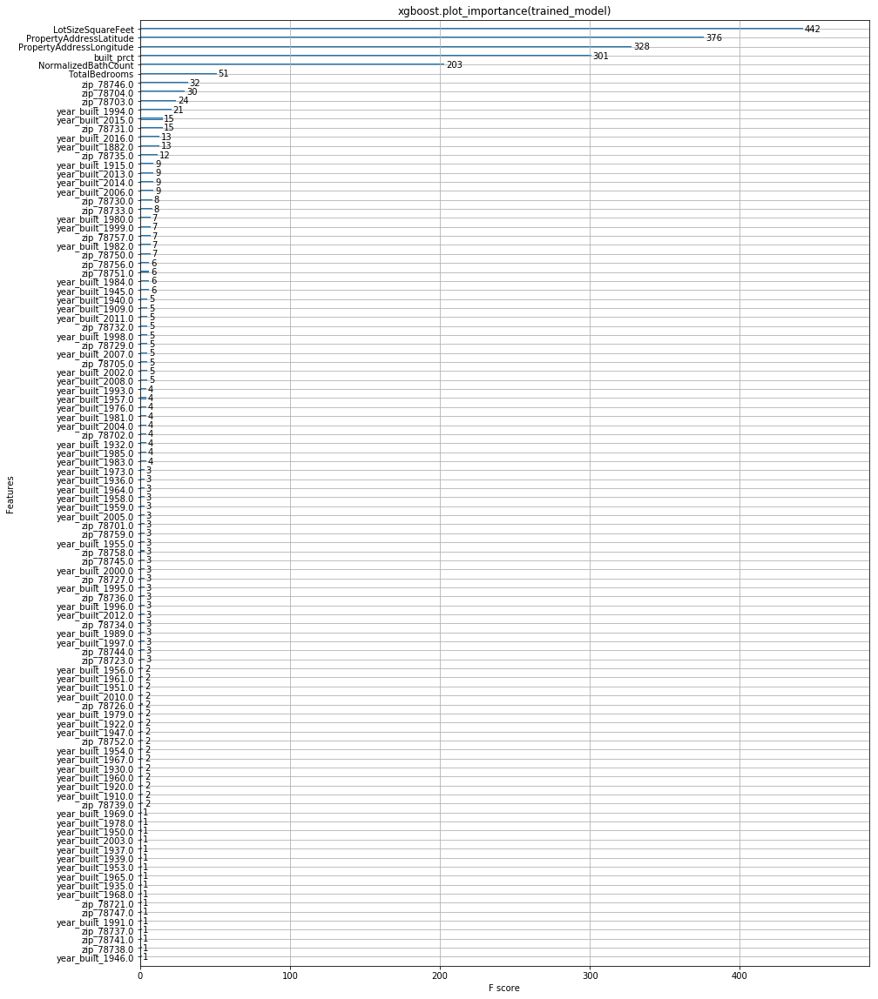

In [22]:
xgboost.plot_importance(trained_model)
plt.title("xgboost.plot_importance(trained_model)")
fig = plt.gcf()
fig.set_size_inches(15, 20)
plt.show()

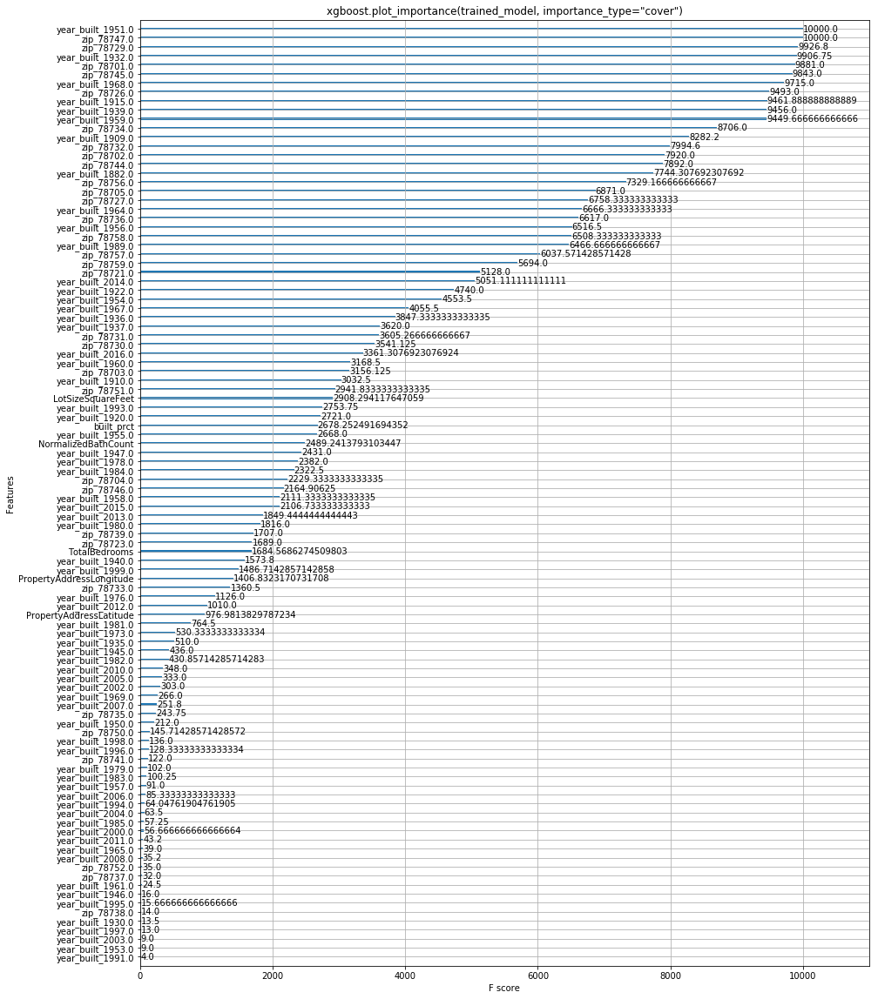

In [23]:
xgboost.plot_importance(trained_model, importance_type="cover")
plt.title('xgboost.plot_importance(trained_model, importance_type="cover")')
fig = plt.gcf()
fig.set_size_inches(15, 20)
plt.show()

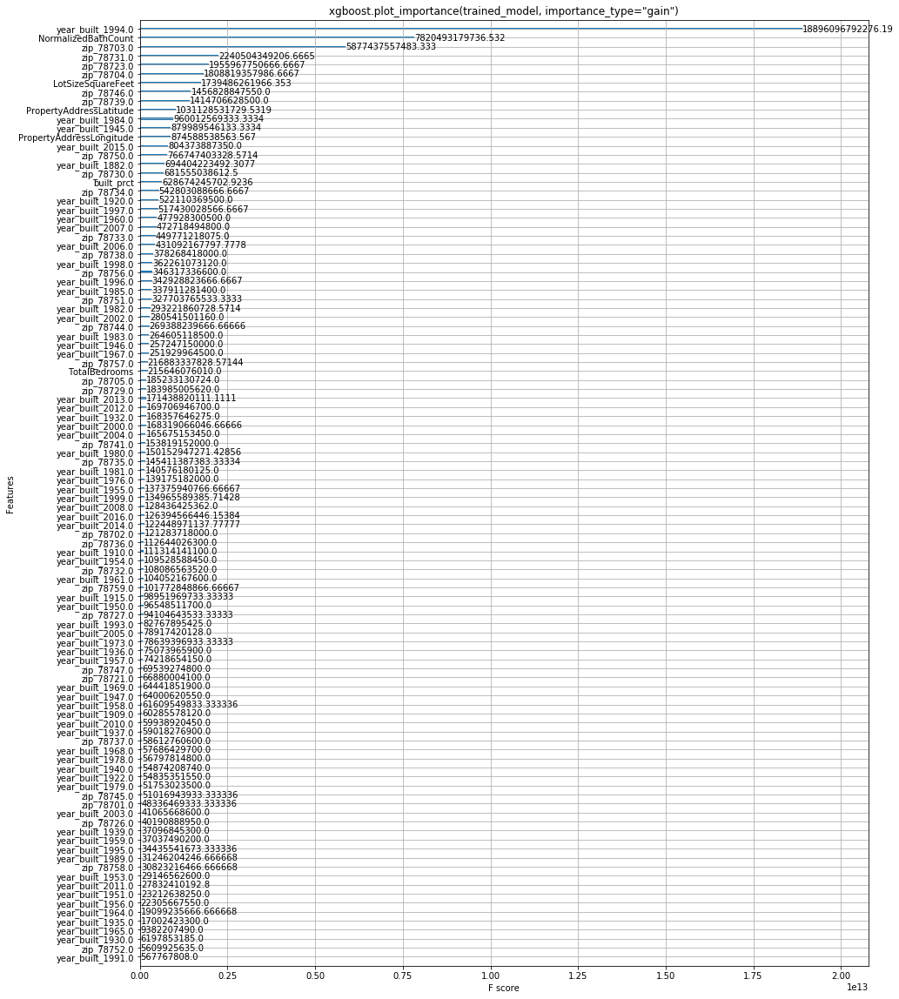

In [24]:
xgboost.plot_importance(trained_model, importance_type="gain")
plt.title('xgboost.plot_importance(trained_model, importance_type="gain")')
fig = plt.gcf()
fig.set_size_inches(15, 20)
plt.show()

### Discussion of initial SHAP importance plots

We see from the first plot traditional importance attributes, i.e. Lot size, lat/long, built%, and # of bathrooms.
The second plot (cover) implies older years (30s, 50s, or even older!) have the most 'cover'.
The third (gain) implies 1994 being by far the most gainful, followed by bathrooms count and some zipcodes. Lot size comes next here.

### Subsample SHAP vizs

In [40]:
# this takes a minute or two since we are explaining over 37180 samples in a model with 100? trees
explainer = shap.TreeExplainer(trained_model)
shap_values = explainer.shap_values(x)

In [41]:
#JS viz code
shap.initjs()

In [42]:
# single prediction viz
shap.force_plot(explainer.expected_value, shap_values[0,:], x.iloc[0,:])

The above explanation shows features each contributing to push the model output from the base value (the average model output over the training dataset we passed) to the model output. Features pushing the prediction higher are shown in red, those pushing the prediction lower are in blue (these force plots are introduced in our Nature BME paper).

If we take many explanations such as the one shown above, rotate them 90 degrees, and then stack them horizontally, we can see explanations for an entire dataset (in the notebook this plot is interactive):

1000 point subsample viz

In [43]:
shap.force_plot(explainer.expected_value, shap_values[:1000,:], x.iloc[:1000,:])

# Bar chart of mean importance
This takes the average of the SHAP value magnitudes across the dataset and plots it as a simple bar chart.

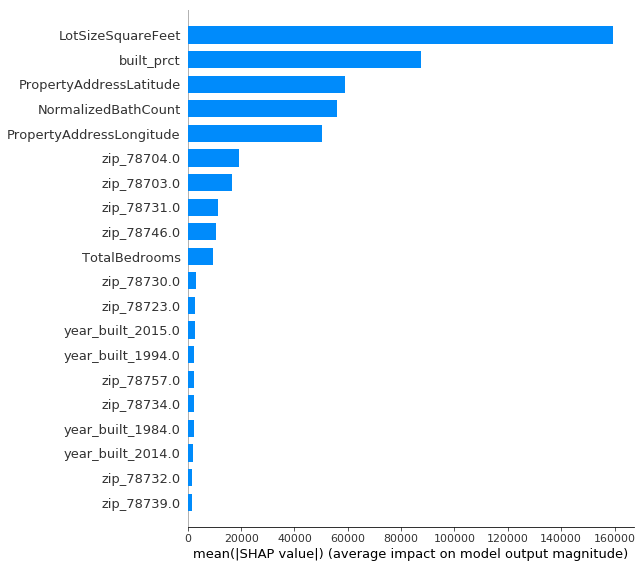

In [30]:
shap.summary_plot(shap_values, x, plot_type="bar")

Bathroom count affects the model less than the percentage built or the latitude, but for samples where it matters, it has more impact that either of these (near the same as lot size square feet)

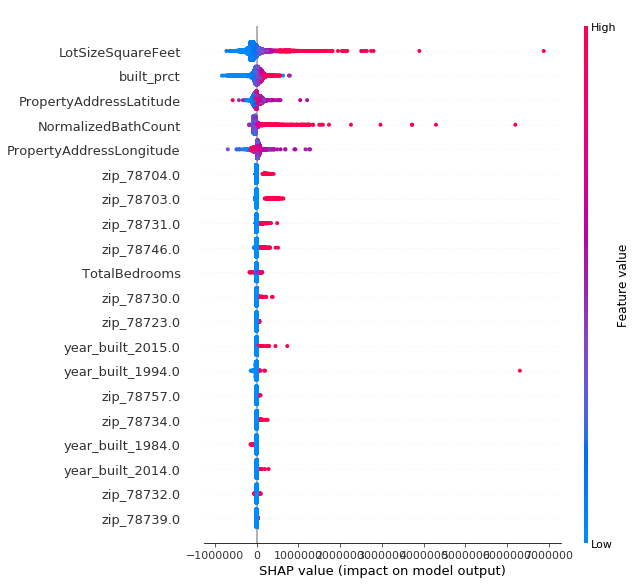

In [32]:
shap.summary_plot(shap_values, x)

# Partial dependence plots, SHAP style

The vertical dispersion of SHAP values at a single feature value is driven by interaction effects, and another feature is chosen for coloring to highlight possible interactions.

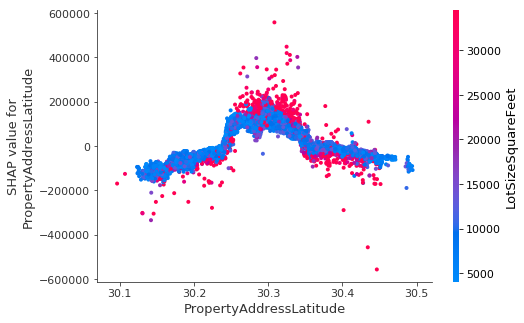

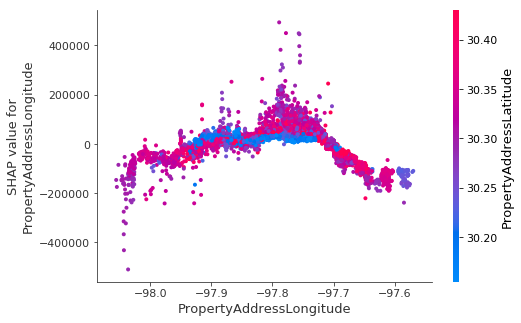

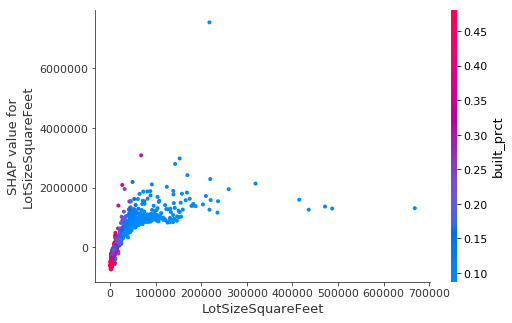

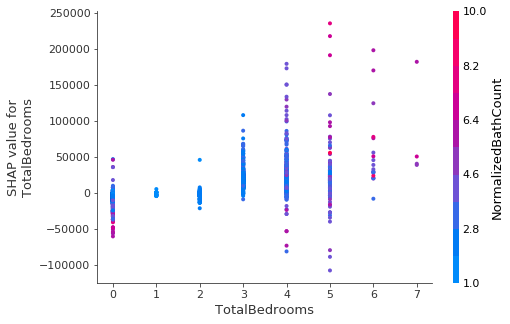

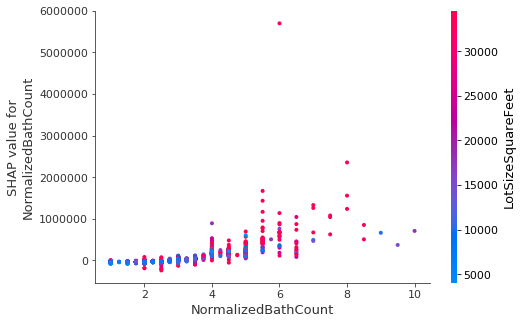

...

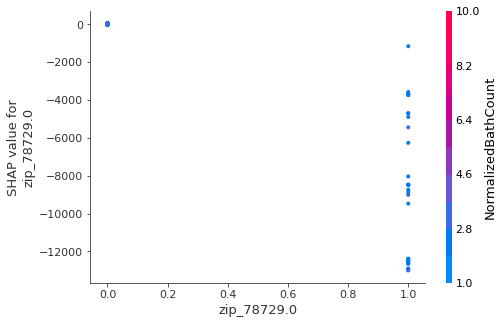

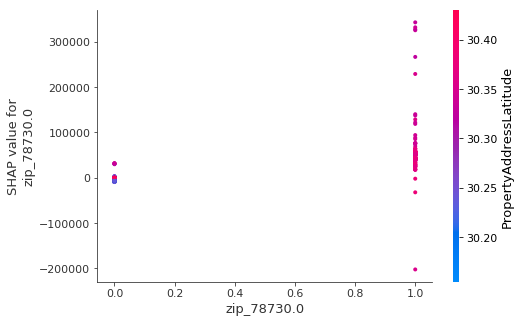

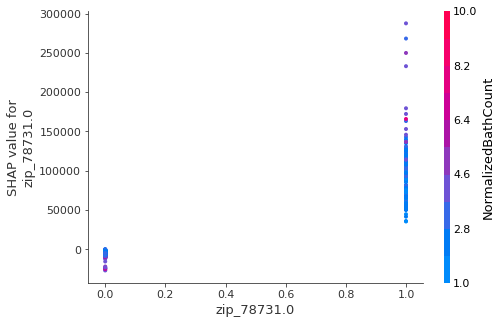

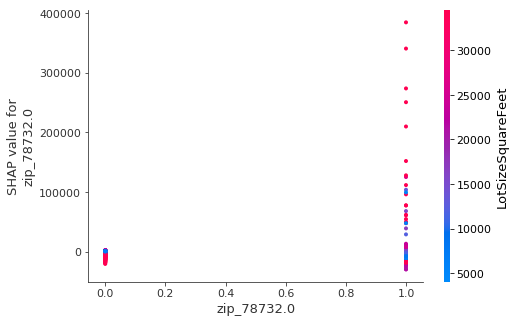

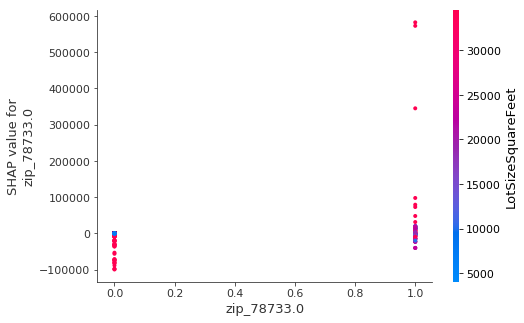

/home/frederic/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/frederic/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


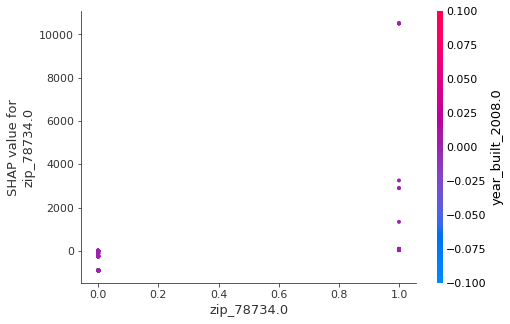

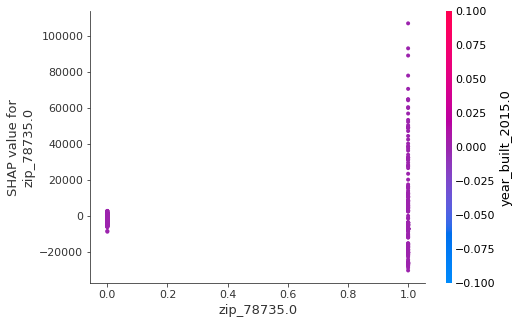

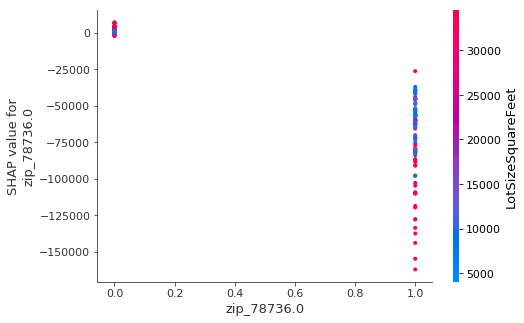

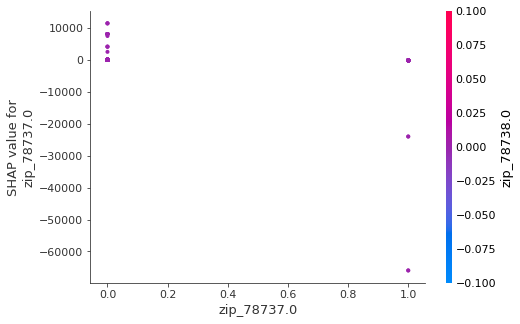

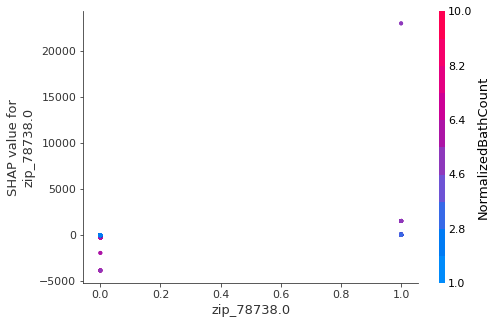

...

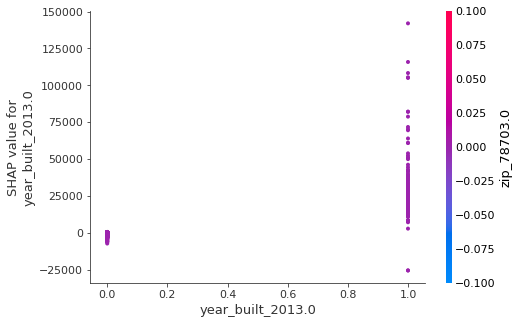

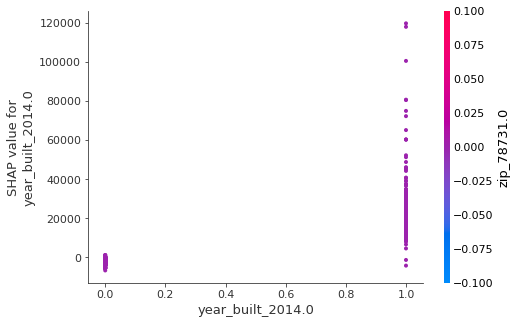

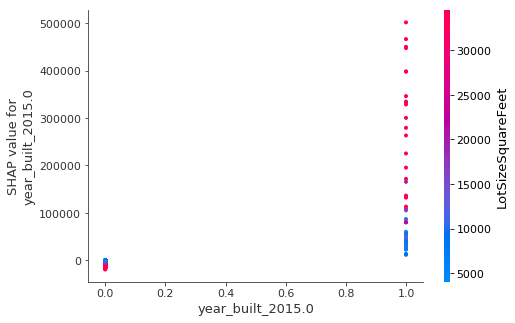

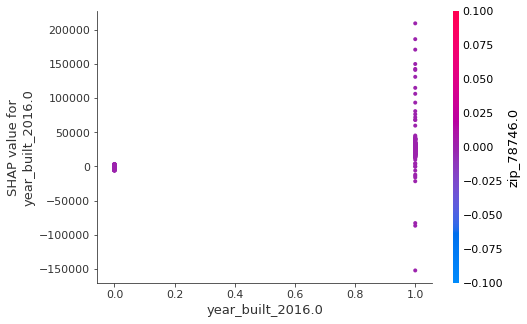

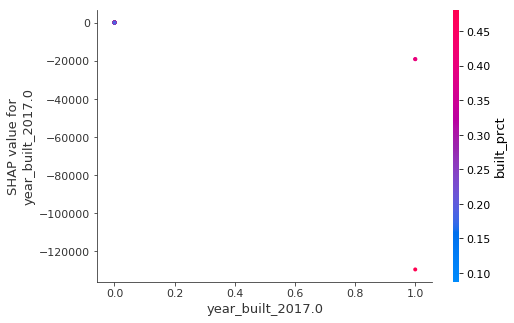

In [44]:
for name in x.columns: #[:6]
    shap.dependence_plot(name, shap_values, x, display_features=x)

##### Note that plots differ somewhat from original analysis below as I have subsampled and re-run these plots

Plot 1:
Lot size matters the most in the middle latitudes (middle of town). Big lots matter a lot in a positive way in town, whereas the opposite is true outside of town! Before 30.25, small lots have a negative efffect that increases towards 0, is shifted up to approx 80k, and then moves slowly down before a shift back to approx $20k at 30.35, at which point the trend continues down at a slower pace until the edge where there is a gapped cluster that is decidedly cheaper (~30.50)

Plot 2 (left to right = west to east): Around -98.05 and -97.95 (especially the latter), small lot sizes have very small effects on price. Big lots from -98.5 to -97.8 increase in importance in an almost 1 to 1 way. Just west of the -97.9 seems to be a shift where small go from somewhat negative (more west) to somewhat positive (more east) for the interaction effect on price. Particulary right in the middle of town they can have a huge effect. There is a lot of dispersion (of all colors) in West Austin though, excluding right in the middle, so we can think of this colorful dispersion as being lot size not being very effectful in price here.

In East Austin there are few big lots and the ones that do exist are far east and affect price little, although any lot size has less and less of an effect as you go eastwards from middle anyways. To this last point, there are slightly larger lots in a cluster around -97.72, that come just before a more vertical (more significant) drop in the effect of lot size vs. plot which may indicate an up-and-coming neighborhood.

Plots 3 and 5:
Plot 3, bathroom count is more important for smaller lots (a few points are more red on the left), and very few bathrooms on a very small lot has a negative effect. 
Plot 5, when bathroom count matters, it matters the most on big lots!

Plot 6:
The most significant effect is that after ~60%, there is a noticeable shift where the lot size matters much more to the price. Seems to be an average difference of about $250,000!

Following these we have a lot of zipcode charts which show some effects of these one hot encoded zips, which are most interesting when there are 2 sided colorful vertical spreads (implying differences in importance from interaction variables depending on whether or not we are considering that zip code vs. all the other zips)

# Simple supervised clustering

Clustering properties by their shap_values leads to groups relevent to the prediction task at hand (property values in this case).

In [43]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

shap_pca = PCA(n_components=12).fit_transform(shap_values[:1000,:])
shap_embedded = TSNE(n_components=2, perplexity=50).fit_transform(shap_values[:1000,:])

In [44]:
#import matplotlib
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.ticker import MaxNLocator
cdict1 = {
    'red': ((0.0, 0.11764705882352941, 0.11764705882352941),
            (1.0, 0.9607843137254902, 0.9607843137254902)),

    'green': ((0.0, 0.5333333333333333, 0.5333333333333333),
              (1.0, 0.15294117647058825, 0.15294117647058825)),

    'blue': ((0.0, 0.8980392156862745, 0.8980392156862745),
             (1.0, 0.3411764705882353, 0.3411764705882353)),

    'alpha': ((0.0, 1, 1),
              (0.5, 1, 1),
              (1.0, 1, 1))
}  # #1E88E5 -> #ff0052
red_blue_solid = LinearSegmentedColormap('RedBlue', cdict1)

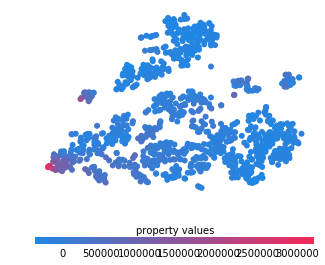

In [55]:
f = pl.figure(figsize=(5,5))
pl.scatter(shap_embedded[:,0],
           shap_embedded[:,1],
           c=shap_values[:1000,:].sum(1).astype(np.float64),
           linewidth=0, alpha=1., cmap=red_blue_solid)
cb = pl.colorbar(label="property values", aspect=40, orientation="horizontal")
cb.set_alpha(1)
cb.draw_all()
cb.outline.set_linewidth(0)
cb.ax.tick_params('x', length=0)
cb.ax.xaxis.set_label_position('top')
pl.gca().axis("off")
pl.show()

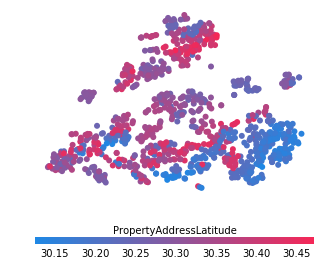

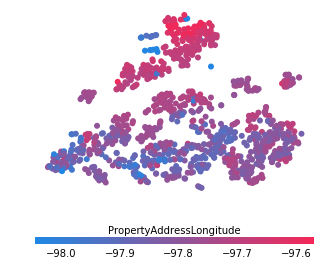

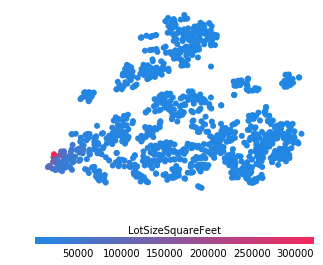

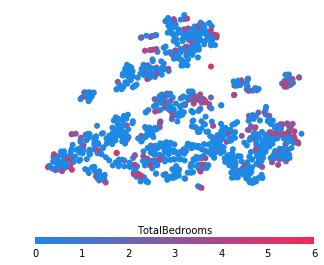

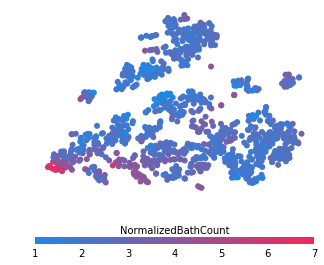

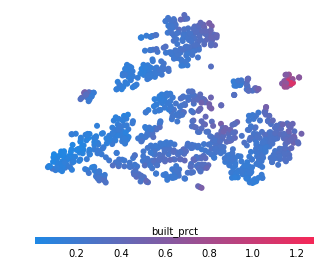

In [54]:
for feature in x.columns[:6]:
    f = pl.figure(figsize=(5,5))
    pl.scatter(shap_embedded[:,0],
               shap_embedded[:,1],
               c=x[feature].values[:1000].astype(np.float64),
               linewidth=0, alpha=1., cmap=red_blue_solid)
    cb = pl.colorbar(label=feature, aspect=40, orientation="horizontal")
    cb.set_alpha(1)
    cb.draw_all()
    cb.outline.set_linewidth(0)
    cb.ax.tick_params('x', length=0)
    cb.ax.xaxis.set_label_position('top')
    pl.gca().axis("off")
    pl.show()

I don't think the first two plots make much sense... Lot size is interesting, with very few large lots and those being in one cluster. High bedroom count is spread out a lot, while bathroom count tends to be clustered (similar to lot size square feet). Built percent is almost a mirror image of lot size, with high built %s in a cluster far away from the high lot size. 

### Other outcome var XGBoost models
Time (months) to sale outcome var

In [45]:
x = downsampled[["PropertyAddressLatitude", "PropertyAddressLongitude", "LotSizeSquareFeet", "TotalBedrooms", "NormalizedBathCount", "built_prct", "price_z"] +\
                            list(OneHotZips.columns.values) +\
                            list(OneHotYearBuilt.columns.values)]
y = downsampled[['MonthsToSale']]
trained_model2 = model.fit(x, y)

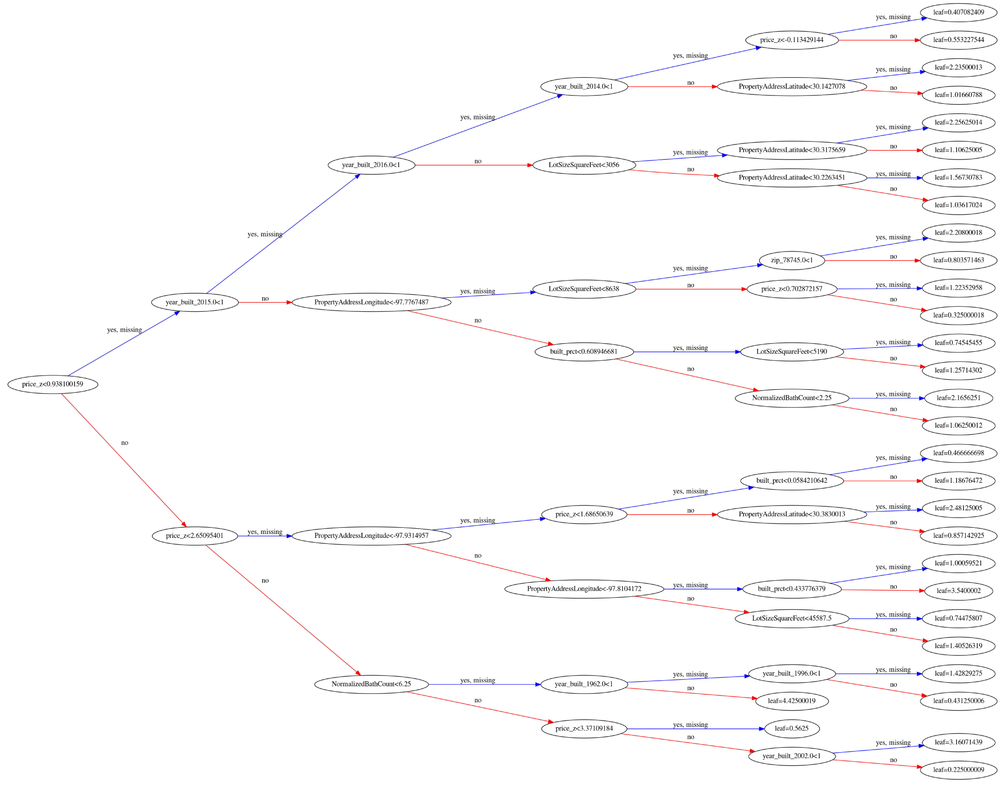

In [25]:
plot_tree(trained_model2, rankdir='LR')
fig2 = matplotlib.pyplot.gcf()
fig2.set_size_inches(150, 100)
fig2.savefig('tree2.png')

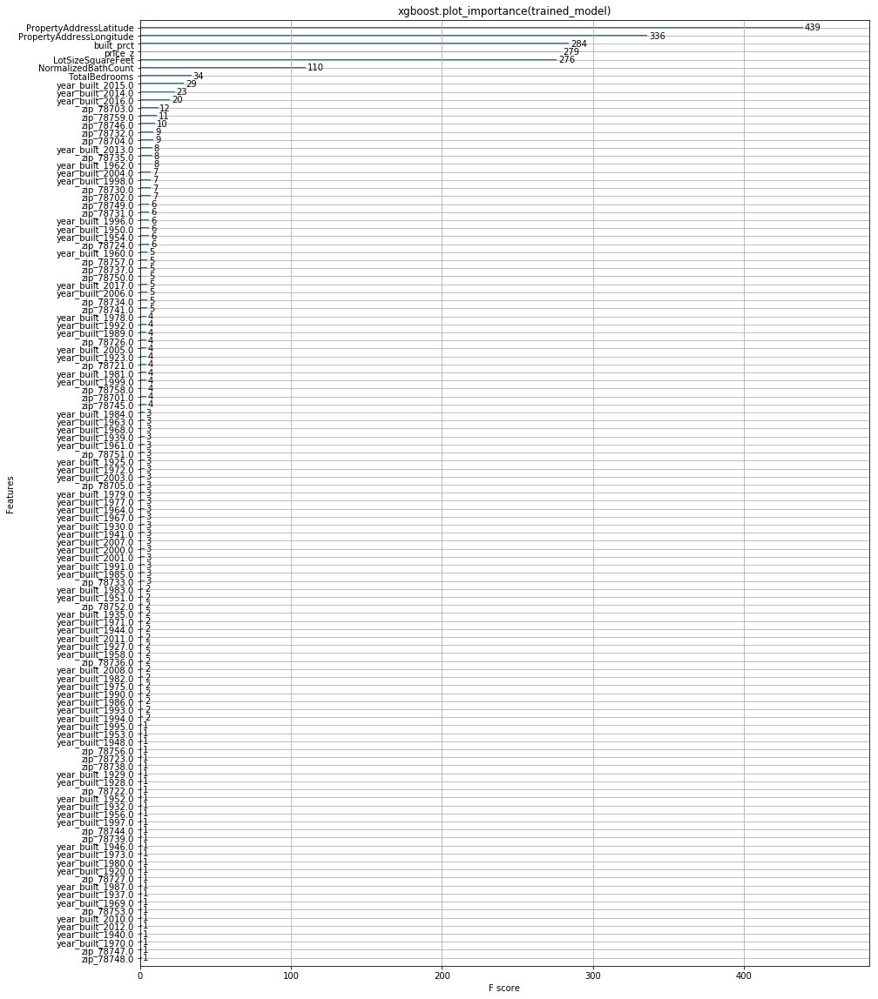

In [15]:
xgboost.plot_importance(trained_model2)
plt.title("xgboost.plot_importance(trained_model)")
fig = plt.gcf()
fig.set_size_inches(15, 20)
plt.show()

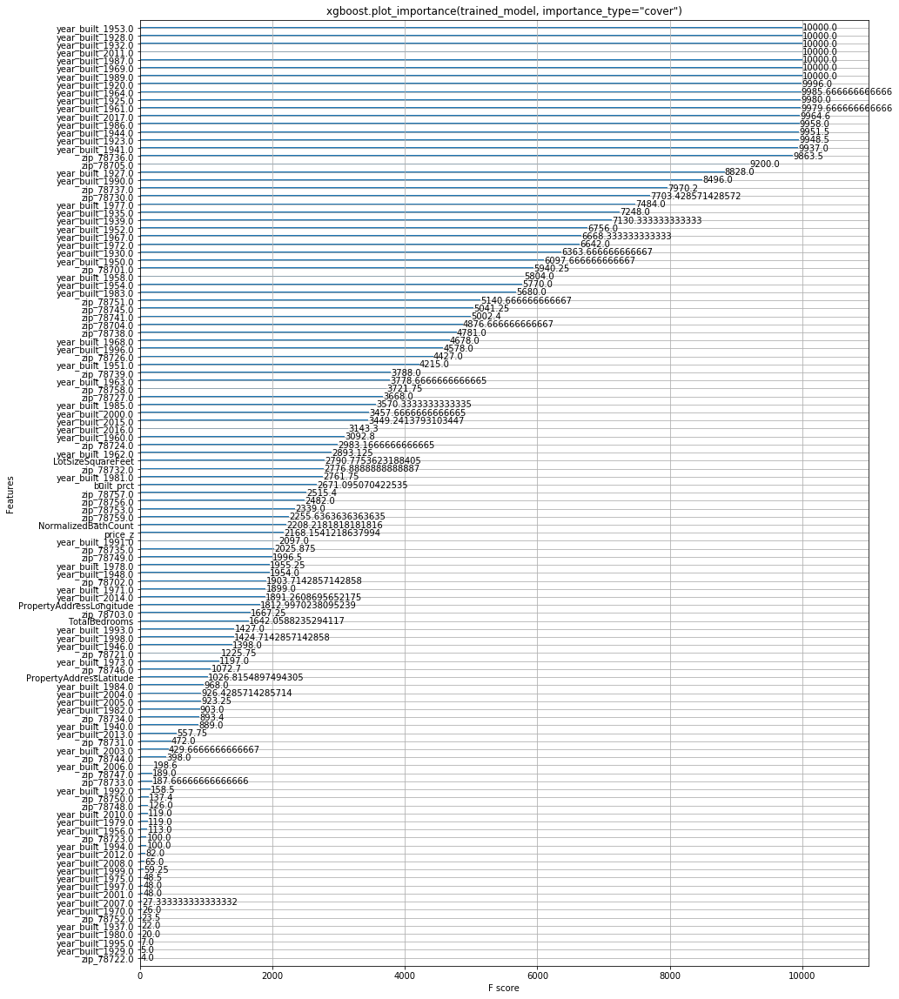

In [16]:
xgboost.plot_importance(trained_model2, importance_type="cover")
plt.title('xgboost.plot_importance(trained_model, importance_type="cover")')
fig = plt.gcf()
fig.set_size_inches(15, 20)
plt.show()

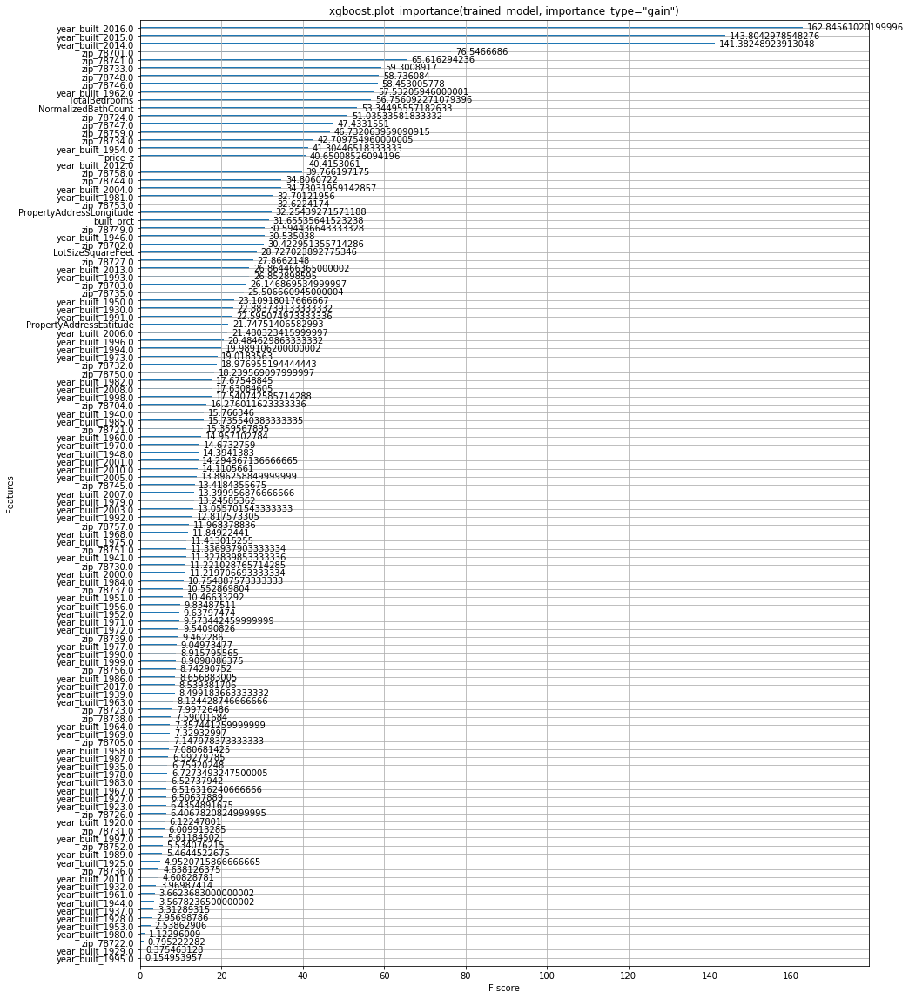

In [17]:
xgboost.plot_importance(trained_model2, importance_type="gain")
plt.title('xgboost.plot_importance(trained_model, importance_type="gain")')
fig = plt.gcf()
fig.set_size_inches(15, 20)
plt.show()

## Discussion of initial SHAP importance plots

We see from the first plot some interesting importance attributes, i.e. lat then long, and built %, lot size and price next. The second plot (cover) implies year of construction often has the most 'cover'. The third (gain) implies modern buildings being by far the most gainful, along with certain zipcodes. 

## Subsample SHAP vizs

In [46]:
# this takes a minute or two since we are explaining over 37180 samples in a model with 100? trees
explainer = shap.TreeExplainer(trained_model2)
shap_values = explainer.shap_values(x)

In [47]:
# single prediction viz
shap.force_plot(explainer.expected_value, shap_values[0,:], x.iloc[0,:])

In [48]:
shap.force_plot(explainer.expected_value, shap_values[:1000,:], x.iloc[:1000,:])

## Bar chart of mean importance

This takes the average of the SHAP value magnitudes across the dataset and plots it as a simple bar chart.

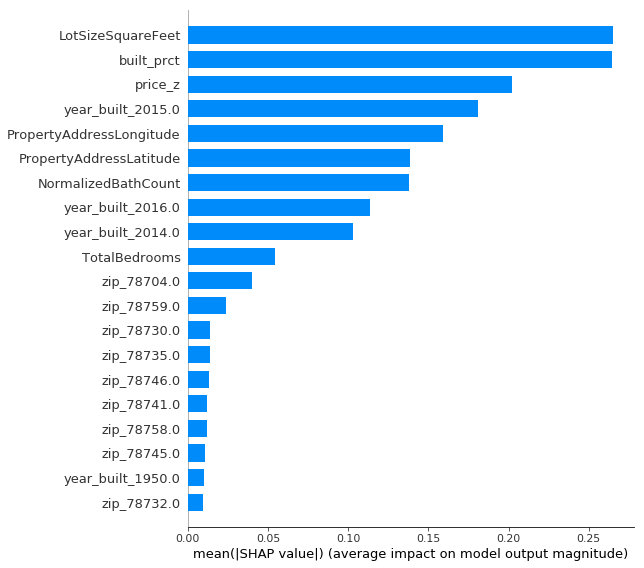

In [21]:
shap.summary_plot(shap_values, x, plot_type="bar")

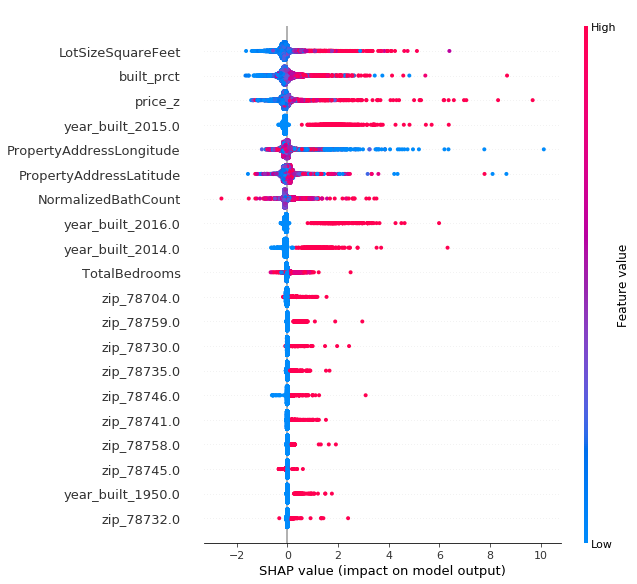

In [22]:
shap.summary_plot(shap_values, x)

## Partial dependence SHAP plots
The vertical dispersion of SHAP values at a single feature value is driven by interaction effects, and another feature is chosen for coloring to highlight possible interactions.

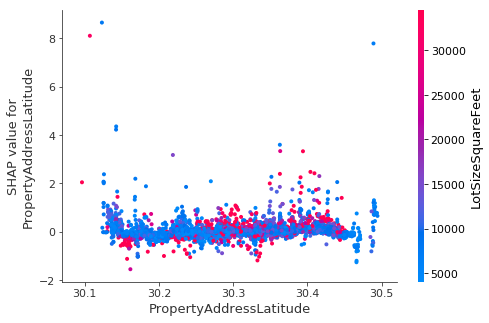

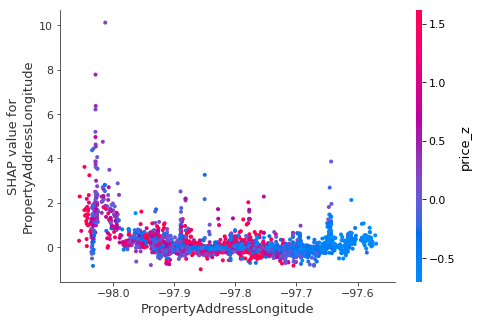

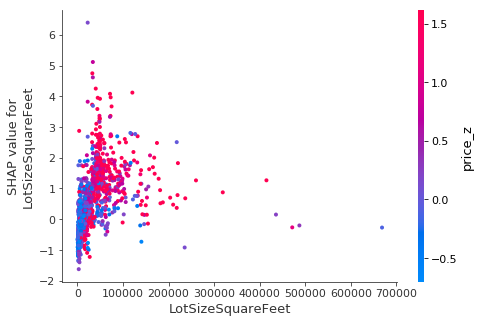

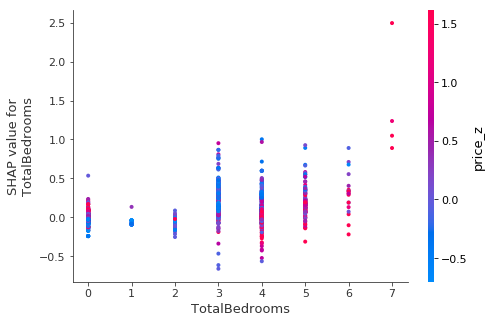

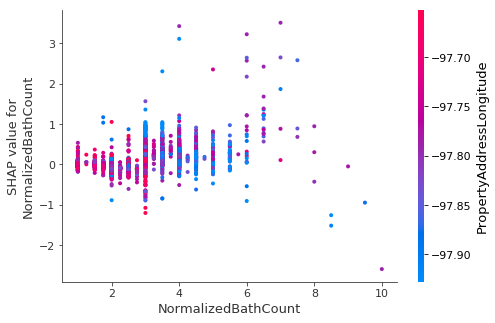

...

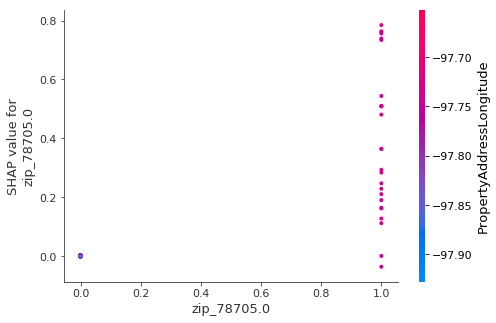

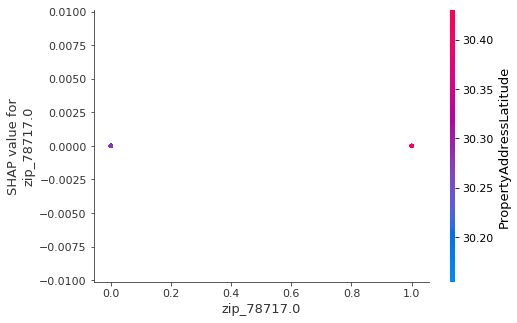

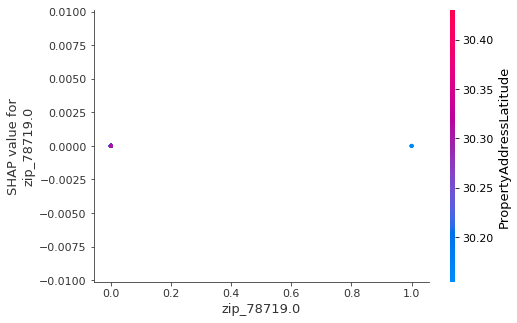

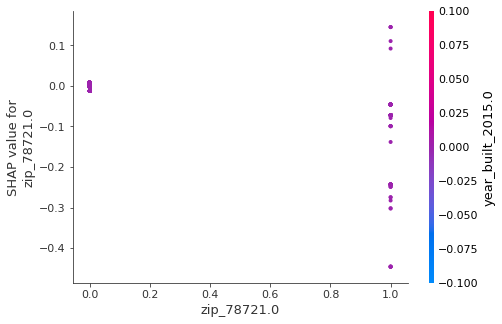

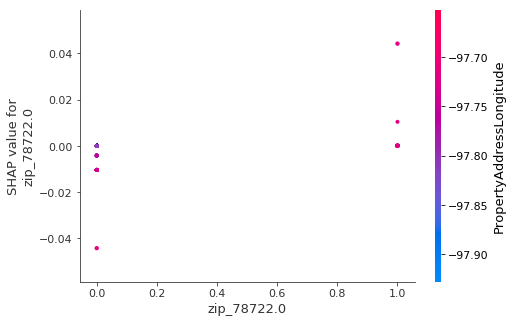

/home/frederic/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/frederic/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


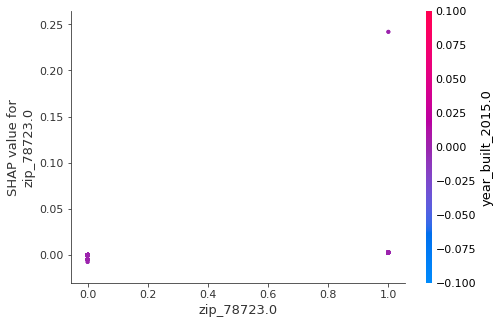

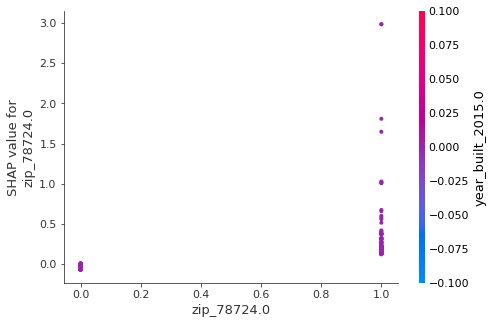

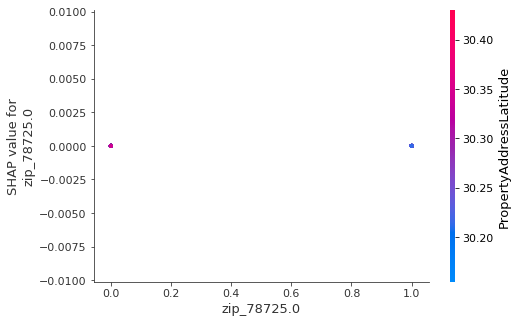

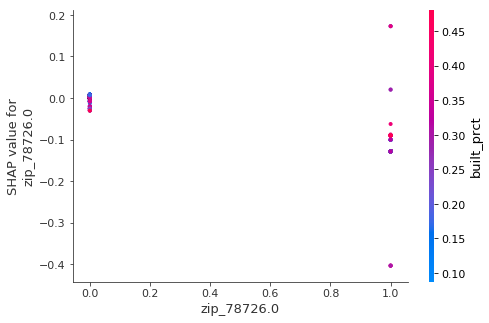

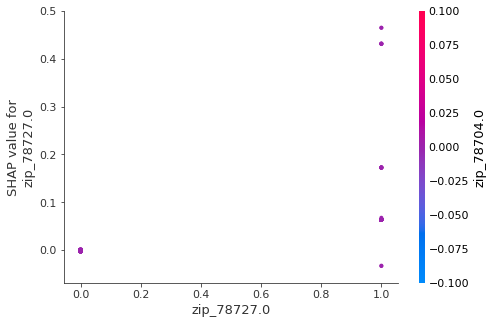

...

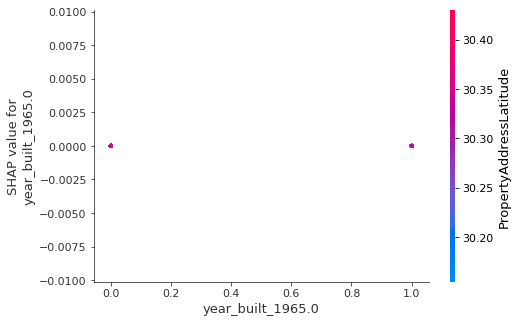

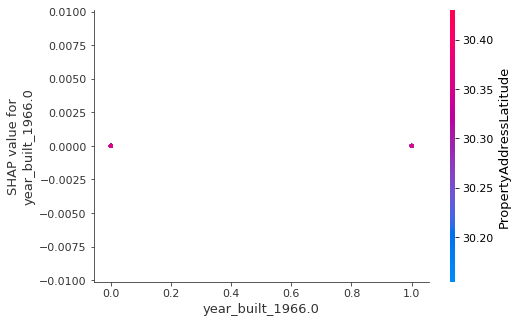

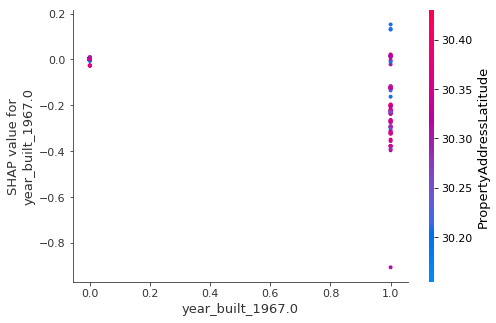

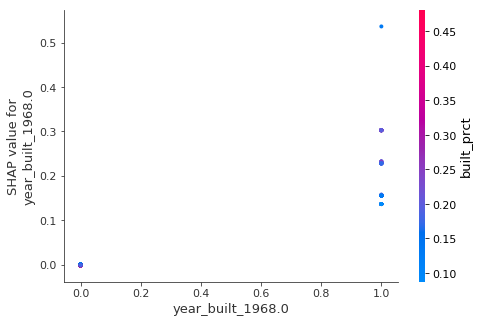

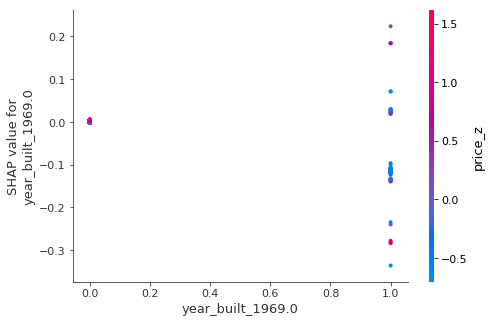

/home/frederic/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/frederic/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


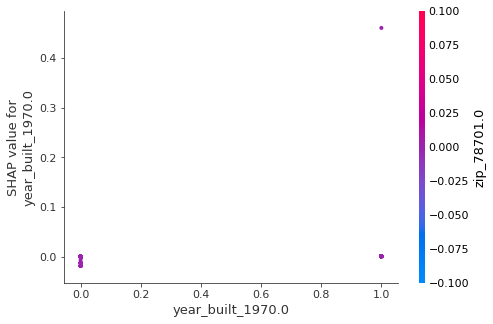

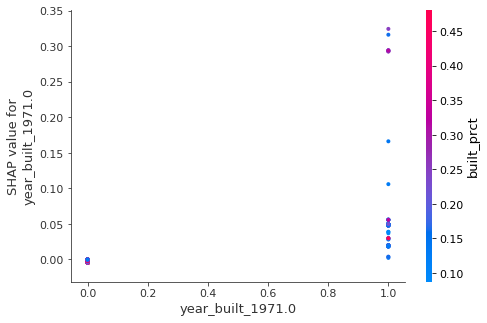

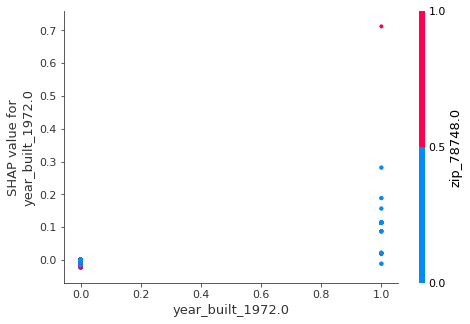

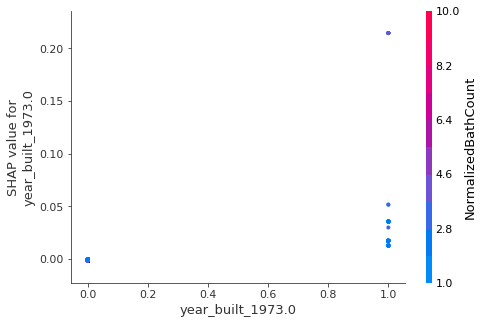

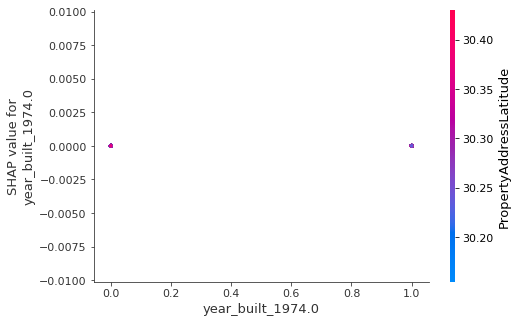

...

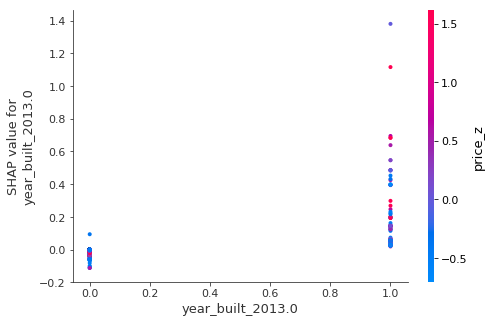

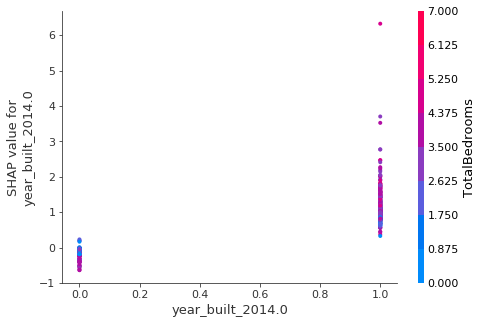

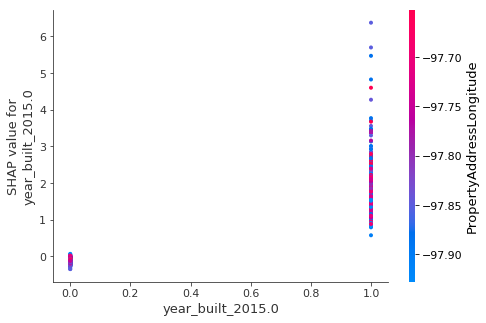

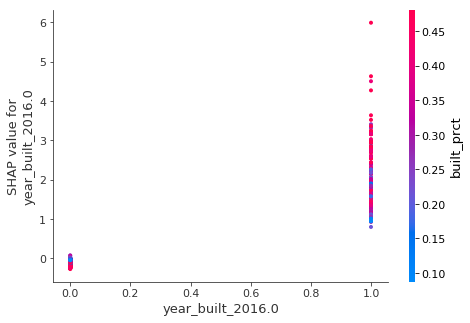

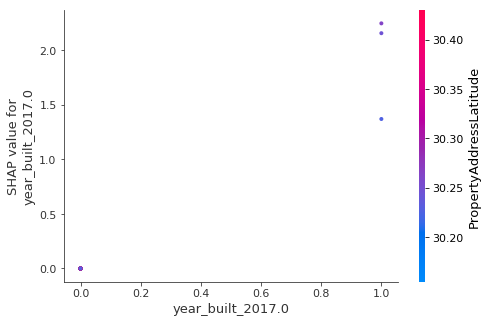

In [24]:
for name in x.columns: #[:6]
    shap.dependence_plot(name, shap_values, x, display_features=x)

With longitude, we see values on the far left (west) tend to be higher, regardless of price... Otherwise time to sale appears pretty consistent. Plot 3 we see large lots tend to take less time to sell. Plot 6, higher built % tends to take somewhat longer to sell. Plot 7 we see a lot of dispersion in time to sell below a normalized price of 10. Zip codes either have a lot of dispersion in time to sell or not much. All construction years tend to have a lot of dispersion, even recent years, implying a lack of correlation between this year built and time to sale.

## Simple supervised clustering

In [26]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

shap_pca = PCA(n_components=12).fit_transform(shap_values[:1000,:])
shap_embedded = TSNE(n_components=2, perplexity=50).fit_transform(shap_values[:1000,:])

In [27]:
#import matplotlib
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.ticker import MaxNLocator
cdict1 = {
    'red': ((0.0, 0.11764705882352941, 0.11764705882352941),
            (1.0, 0.9607843137254902, 0.9607843137254902)),

    'green': ((0.0, 0.5333333333333333, 0.5333333333333333),
              (1.0, 0.15294117647058825, 0.15294117647058825)),

    'blue': ((0.0, 0.8980392156862745, 0.8980392156862745),
             (1.0, 0.3411764705882353, 0.3411764705882353)),

    'alpha': ((0.0, 1, 1),
              (0.5, 1, 1),
              (1.0, 1, 1))
}  # #1E88E5 -> #ff0052
red_blue_solid = LinearSegmentedColormap('RedBlue', cdict1)

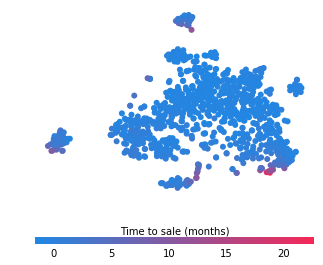

In [28]:
f = pl.figure(figsize=(5,5))
pl.scatter(shap_embedded[:,0],
           shap_embedded[:,1],
           c=shap_values[:1000,:].sum(1).astype(np.float64),
           linewidth=0, alpha=1., cmap=red_blue_solid)
cb = pl.colorbar(label="Time to sale (months)", aspect=40, orientation="horizontal")
cb.set_alpha(1)
cb.draw_all()
cb.outline.set_linewidth(0)
cb.ax.tick_params('x', length=0)
cb.ax.xaxis.set_label_position('top')
pl.gca().axis("off")
pl.show()

We have a few spots that take longer to sell, seeming to be at the 'edge' of a neighborhood/cluster

## Normalized Sales Premium outcome model

In [30]:
x = downsampled[["PropertyAddressLatitude", "PropertyAddressLongitude", "LotSizeSquareFeet", "TotalBedrooms", "NormalizedBathCount", "built_prct", "price_z"] +\
                            list(OneHotZips.columns.values) +\
                            list(OneHotYearBuilt.columns.values)]
y = downsampled[['NormalizedSalesPremium']]*100
trained_model3 = model.fit(x, y)

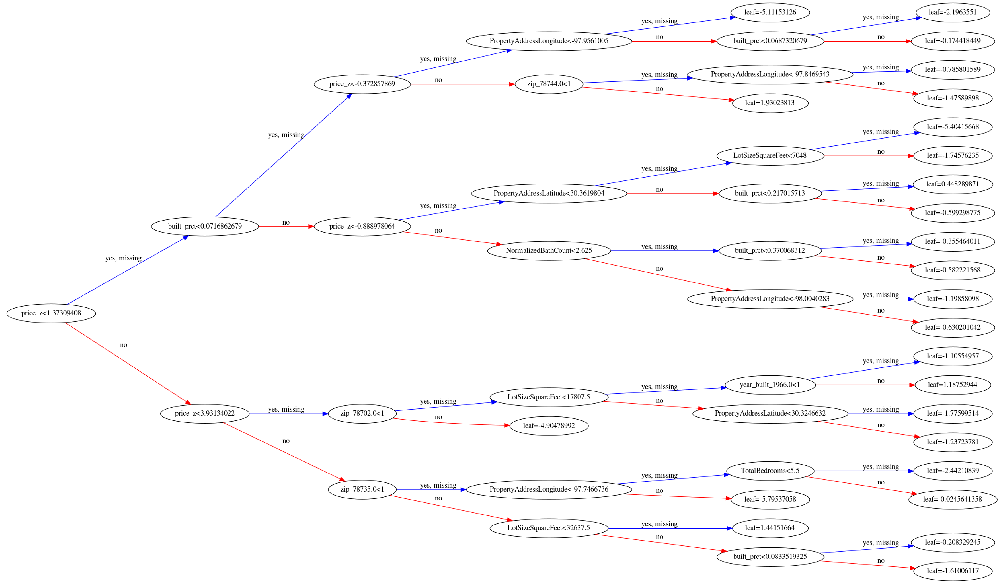

In [31]:
plot_tree(trained_model3, rankdir='LR')
fig3 = matplotlib.pyplot.gcf()
fig3.set_size_inches(150, 100)
fig3.savefig('tree3.png')